<a href="https://colab.research.google.com/github/nikosavola/HeisenbergMetropolis-StatMech/blob/main/LabAstro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Observational Astronomy Group 2**

**Importar Bibliotecas**

In [16]:
import numpy as np
import scipy
import matplotlib.pyplot as plt
from astropy.io import fits
import requests,io
import os

**Importar Ficheiros**




In [17]:
urldir= 'https://baltasar.centra.tecnico.ulisboa.pt/~sgonzalez/LabAst_2022/' 
from bs4 import BeautifulSoup

import warnings # ignore annoying warnings
warnings.filterwarnings(action='ignore', module='urllib3')

def get_files(url, day): # from an online directory
  files = []
  html_doc = requests.get(url,verify=False).text
  soup = BeautifulSoup(html_doc, 'html.parser')
  for link in soup.find_all('a'):
    #print(link.get('href'))
    files.append(link.get('href'))
  # cleaning up files that are NOT science  
  if(day == 26):
    trash = list(range(1,18))
    trash += list(range(51,53))
    trash += [72]
    trash += [128]
    trash += [129]
    trash += list(range(130,134))
    trash += [140]
    trash += [141]
    trash += [147]
    trash += [153]
    trash += list(range(246,253))
    
  if(day == 27):
    trash = list(range(83,93))
    trash += [110]
    trash += [111]
    trash += list(range(153,157))
    trash += [182]
    trash += [275]
    trash += list(range(414,417))
    trash += list(range(423,427))
      
  if(day == 28):
    trash = [727]
    trash += [727]
    trash += list(range(131,137))
    trash += [351]
    
  if(day == 29):
    trash = [50]
    trash += list(range(147,151))
    trash += list(range(301,305))
    trash = [345]
    
  for i in trash:
    for j in files:
        if j.endswith("0" + str(i) + ".fits"): 
            files.remove(j) 
  #for j in files:
  #  print(j)
  return files    


def open_image(url): # for fits files
  return fits.open(io.BytesIO(requests.get(url,verify=False).content))

**Obter Master Bias e Master Flat**

In [18]:
#OLD
"""def master_flat(day):
  day_path = "2022-09-" + str(day) + "/"
  directory = urldir + day_path
  flat = []
  for filename in get_files(directory,day):
      if filename.startswith("flat"): # needs fine tuning
        filepath = urldir+day_path+filename
        flat.append(open_image(filepath)[0].data)
  flat = np.asarray(flat)
  masterbias = master_bias(day)
  new_flats = []
  for image in flat:
    image = image - masterbias
    image = image / np.median(image) # using /= gives a weird error
    new_flats.append(image)
  masterflat = np.median(new_flats,axis=0) 
  return masterflat"""

'def master_flat(day):\n  day_path = "2022-09-" + str(day) + "/"\n  directory = urldir + day_path\n  flat = []\n  for filename in get_files(directory,day):\n      if filename.startswith("flat"): # needs fine tuning\n        filepath = urldir+day_path+filename\n        flat.append(open_image(filepath)[0].data)\n  flat = np.asarray(flat)\n  masterbias = master_bias(day)\n  new_flats = []\n  for image in flat:\n    image = image - masterbias\n    image = image / np.median(image) # using /= gives a weird error\n    new_flats.append(image)\n  masterflat = np.median(new_flats,axis=0) \n  return masterflat'

In [19]:
def plot_image(image, colormap):
  lo,up = np.percentile(image,1),np.percentile(image,99)
  plt.figure()
  plt.imshow(image,cmap=colormap,origin='lower',clim=(lo,up))
  plt.colorbar()
  plt.xlabel('xpix')
  plt.ylabel('ypix')


In [20]:
def filter_files_new(url, day, targets): #NEW working fine
  files = []
  for link in get_files(url,day):
    if all(target in link.lower() for target in targets): # handle different capitalizations
      files.append(url+link)

  #print(files)
  return files

science_black = filter_files_new(urldir+"2022-09-26/", 26,('hip101748','black')) + filter_files_new(urldir+"2022-09-26/", 26,('go%20cyg','black')) + filter_files_new(urldir+"2022-09-27/", 27,('go%20cyg','black')) + filter_files_new(urldir+"2022-09-28/", 28,('gocyg','black')) + filter_files_new(urldir+"2022-09-29/", 29,('go%20cyg','black'))
science_blue = filter_files_new(urldir+"2022-09-26/", 26,('hip101748','blue')) + filter_files_new(urldir+"2022-09-26/", 26,('go%20cyg','blue')) + filter_files_new(urldir+"2022-09-27/", 27,('go%20cyg','blue')) + filter_files_new(urldir+"2022-09-28/", 28,('gocyg','blue')) + filter_files_new(urldir+"2022-09-29/", 29,('go%20cyg','blue'))
science_red = filter_files_new(urldir+"2022-09-26/", 26,('hip101748','red')) + filter_files_new(urldir+"2022-09-26/", 26,('go%20cyg','red')) + filter_files_new(urldir+"2022-09-27/", 27,('go%20cyg','red')) + filter_files_new(urldir+"2022-09-28/", 28,('gocyg','red')) + filter_files_new(urldir+"2022-09-29/", 29,('go%20cyg','red'))
science_green = filter_files_new(urldir+"2022-09-26/", 26,('hip101748','green')) + filter_files_new(urldir+"2022-09-26/", 26,('go%20cyg','green')) + filter_files_new(urldir+"2022-09-27/", 27,('go%20cyg','green')) + filter_files_new(urldir+"2022-09-28/", 28,('gocyg','green')) + filter_files_new(urldir+"2022-09-29/", 29,('go%20cyg','green'))

print('# science black = ', len(science_black))
print('# science blue = ', len(science_blue))
print('# science red = ', len(science_red))
print('# science green = ', len(science_green))

# science black =  84
# science blue =  50
# science red =  50
# science green =  50


bias

In [21]:
def master_bias():
  days = [26,27,28,29]
  bias = []
  for day in days:
    day_path = "2022-09-" + str(day) + "/"
    directory = urldir + day_path
    for filename in get_files(directory,day):
        if filename.startswith("bias"): # needs fine tuning
          filepath = urldir+day_path+filename
          bias.append(open_image(filepath)[0].data)
  bias = np.asarray(bias)
  read_out = np.array(bias.std(axis=0))
  masterbias = np.median(bias,axis=0)
  print(masterbias.min())
  masterbias = np.asarray(masterbias)
  return masterbias,read_out

In [22]:
masterbias,read_out = master_bias()

552.0


In [23]:
gain = 1.5 # e- / ADU
print(read_out*gain)
print(read_out.max())
print(read_out.min())
print(read_out.mean())

[[14.4560794  15.56355144 16.16744633 ... 15.1153764  16.5384651
  16.08815743]
 [16.3141278  16.2154352  16.47630697 ... 16.43588767 16.09796417
  15.2395721 ]
 [15.94096877 16.49568526 14.6272599  ... 16.1970739  16.31917604
  16.26128699]
 ...
 [41.00944595 15.79517342 17.55739236 ... 17.3772309  17.24881933
  17.11410636]
 [45.61782427 17.16399706 16.37625328 ... 17.51951344 17.51024962
  17.86298219]
 [46.00075657 17.26371952 16.65213511 ... 17.45439021 19.79106466
  17.17094757]]
116.96200648846772
8.615304774955684
10.79297540072528


In [24]:
print(masterbias.max())
print(len(masterbias))

695.0
1024


flat

In [28]:
def master_flat(target):
  days = [26,27,28,29]
  flat = []

  for day in days:
    day_path = "2022-09-" + str(day) + "/"
    directory = urldir + day_path
    for filename in get_files(directory,day):
        if filename.startswith("flat"): # needs fine tuning
          if target in filename:
            filepath = urldir+day_path+filename
            flat.append(open_image(filepath)[0].data)
  
  flat = np.asarray(flat)
  new_flats = []
  flats_std = []
  for image in flat:
    image = image - masterbias
    flats_std.append(np.sqrt(read_out**2+image)/np.median(image))
    image = image / np.median(image) # using /= gives a weird error
    new_flats.append(image)
  masterflat = np.median(new_flats,axis=0) 
  masterflat = np.asarray(masterflat)
  flats_std = np.median(flats_std,axis=0)
  return masterflat,flats_std


masterflat_black,flats_std_black = master_flat('black')
#masterflat_blue,flats_std_blue = master_flat('blue')
#masterflat_red,flats_std_red = master_flat('red')
#masterflat_green,flats_std_green = master_flat('green')
#############################################

In [29]:
print(masterflat_black)
print(" ----- ")
print(flats_std_black)
print(flats_std_black.max())
print(flats_std_black.min())
print(flats_std_black.mean())

[[0.90049483 0.98972678 0.98684551 ... 1.00906302 1.01332615 0.8882367 ]
 [0.93489722 1.02828153 1.02802365 ... 1.04167753 1.04575964 0.92251108]
 [0.92804524 1.02027048 1.01548265 ... 1.03240551 1.0423367  0.91514101]
 ...
 [0.9132064  1.00227328 0.99685113 ... 1.00408225 1.01082527 0.89419582]
 [0.91212939 0.99551516 0.99012973 ... 0.99986149 1.0078601  0.89284367]
 [0.82171828 0.87672313 0.8726825  ... 0.87540306 0.87897736 0.78163058]]
 ----- 
[[0.00519494 0.00543853 0.00543055 ... 0.00549554 0.00550474 0.00514358]
 [0.00530242 0.00558823 0.00559365 ... 0.00562489 0.00562117 0.0052363 ]
 [0.00527079 0.00557543 0.00556357 ... 0.0055995  0.0056148  0.00522137]
 ...
 [0.0053027  0.00550634 0.00549465 ... 0.00551382 0.00550999 0.00517288]
 [0.00528049 0.00548145 0.00548139 ... 0.00548258 0.0054964  0.00519084]
 [0.00505167 0.00511317 0.00511451 ... 0.00513608 0.00513644 0.00484332]]
0.006622805135434405
0.004843324453199395
0.005508262775626511


[Text(0, 0.5, 'ypix'), Text(0.5, 0, 'xpix')]

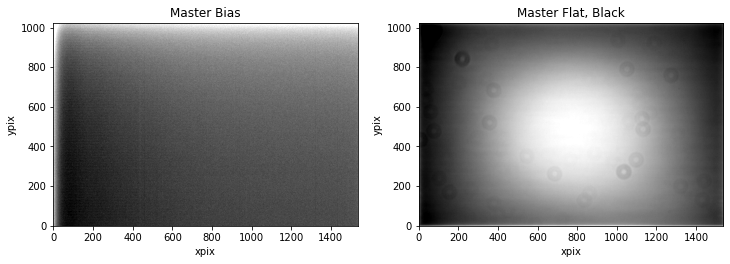

In [30]:
# plot master and bias
fig,ax = plt.subplots(1,2,figsize=(12,6))


lo,up = np.percentile(masterbias,1),np.percentile(masterbias,99)
ax[0].imshow(masterbias,cmap='gray',origin='lower',clim=(lo,up))


lo,up = np.percentile(masterflat_black,1),np.percentile(masterflat_black,99)
ax[1].imshow(masterflat_black,cmap='gray',origin='lower',clim=(lo,up))


ax[0].set_title('Master Bias')
ax[1].set_title('Master Flat, Black')

ax[0].set(xlabel='xpix', ylabel='ypix')
ax[1].set(xlabel='xpix', ylabel='ypix')


reduce images

In [31]:
def reduce(science, masterbias, masterflat,flats_std):
  reduced_science = []
  image_std = []
  for file in science:
    image = np.asarray(open_image(file)[0].data)
    image_std.append(np.sqrt((image- masterbias+read_out**2)/masterflat**2+flats_std**2/(image-masterbias)**2))
    image = (image - masterbias) / masterflat
    print(np.shape(image))
    reduced_science.append(image)
  return reduced_science,image_std

In [42]:
reduced_science_black,reduced_std_black = reduce(science_black, masterbias, masterflat_black,flats_std_black)
reduced_science_blue = reduce(science_blue, masterbias, masterflat_blue)
reduced_science_red = reduce(science_red, masterbias, masterflat_red)
reduced_science_green = reduce(science_green, masterbias, masterflat_green)

(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)


KeyboardInterrupt: ignored

In [33]:
reduced_science_blue,reduced_std_blue = reduce(science_blue, masterbias, masterflat_black,flats_std_black)

(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in true_divide
  


(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)
(1024, 1536)


In [34]:
print(np.shape(reduced_science_black))
#plt.imshow(reduced_science_black[40])

(84, 1024, 1536)


In [35]:
pip install astroalign

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


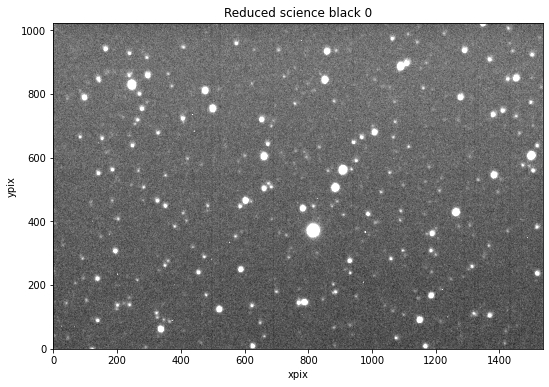

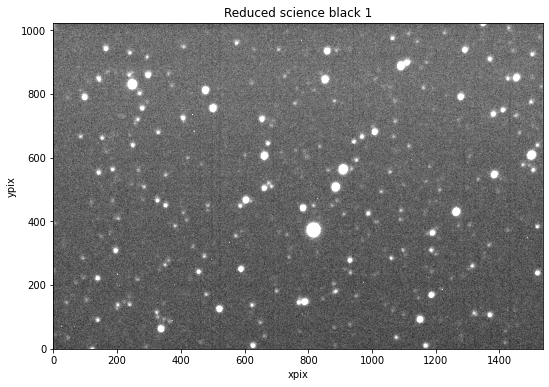

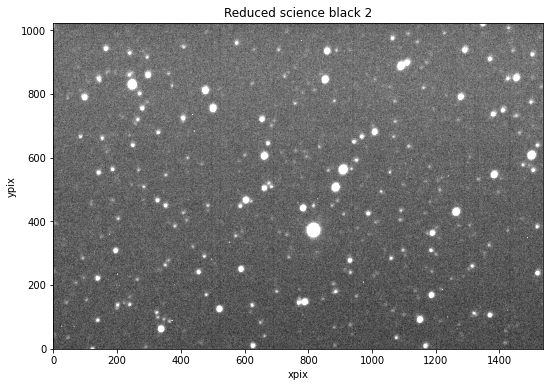

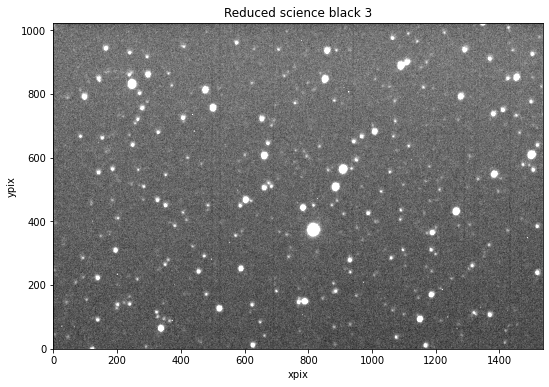

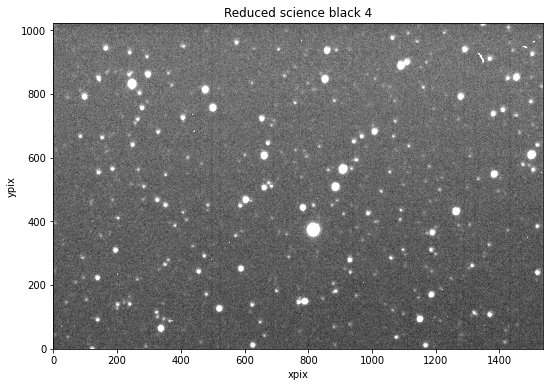

...

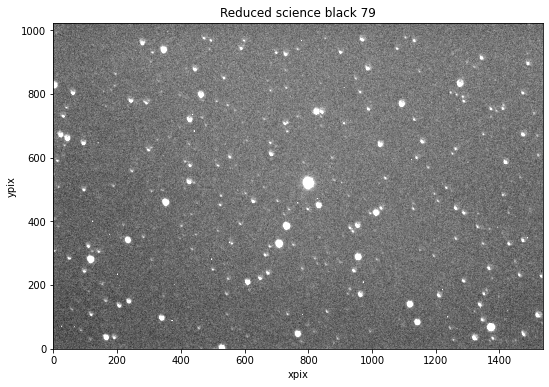

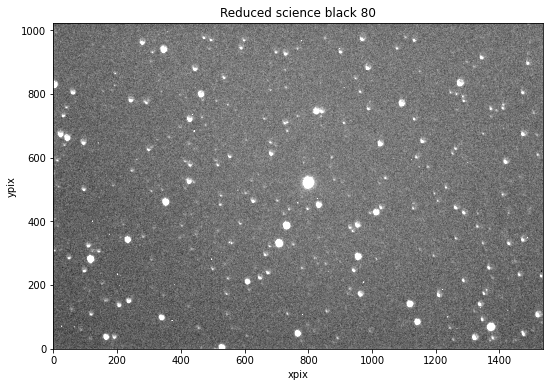

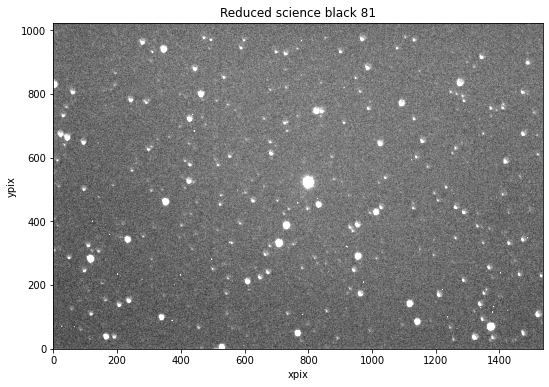

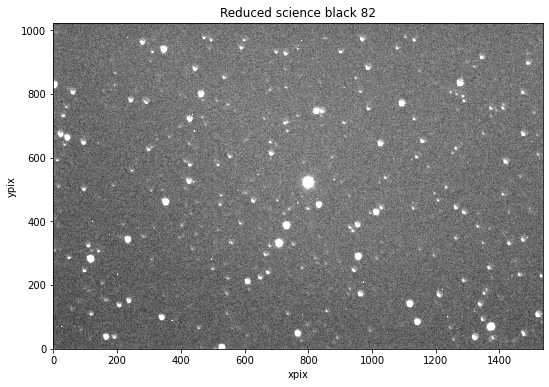

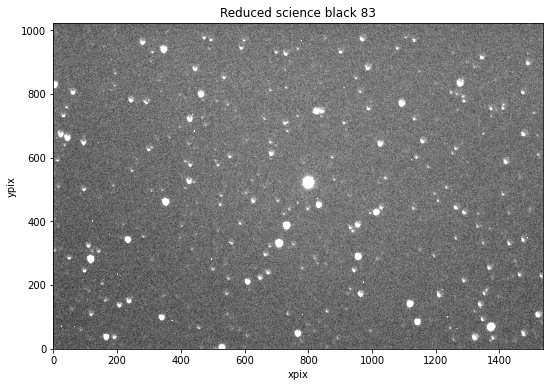

In [36]:
k=0
for i in reduced_science_black:

  fig,ax = plt.subplots(1,1,figsize=(12,6))

  lo,up = np.percentile(i,1),np.percentile(i,99)
  ax.imshow(i,cmap='gray',origin='lower',clim=(lo,up))

  ax.set_title('Reduced science black %i' %k)
  k=k+1
  ax.set(xlabel='xpix', ylabel='ypix')







In [ ]:
k=0
for i in reduced_science_blue:

  fig,ax = plt.subplots(1,1,figsize=(12,6))

  lo,up = np.percentile(i,1),np.percentile(i,99)
  ax.imshow(i,cmap='gray',origin='lower',clim=(lo,up))

  ax.set_title('Reduced science blue %i' %k)
  k=k+1
  ax.set(xlabel='xpix', ylabel='ypix')


k=0
for i in reduced_science_green:

  fig,ax = plt.subplots(1,1,figsize=(12,6))

  lo,up = np.percentile(i,1),np.percentile(i,99)
  ax.imshow(i,cmap='gray',origin='lower',clim=(lo,up))

  ax.set_title('Reduced science green %i' %k)
  k=k+1
  ax.set(xlabel='xpix', ylabel='ypix')

k=0
for i in reduced_science_red:

  fig,ax = plt.subplots(1,1,figsize=(12,6))

  lo,up = np.percentile(i,1),np.percentile(i,99)
  ax.imshow(i,cmap='gray',origin='lower',clim=(lo,up))

  ax.set_title('Reduced science red %i' %k)
  k=k+1
  ax.set(xlabel='xpix', ylabel='ypix')



Testing alignment function

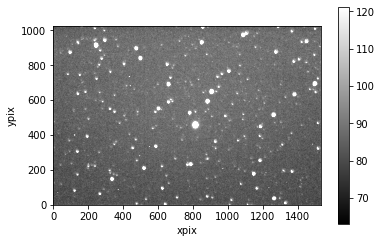

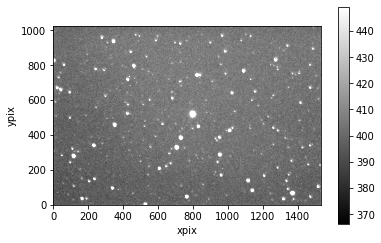

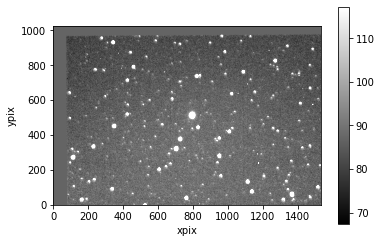

In [39]:
import astroalign as aa
##teste. 69 79

aligned_image, footprint = aa.register(reduced_science_black[69], reduced_science_black[79]) #alinha a 1a para ficar na posicao da 2a

plot_image(reduced_science_black[69], 'gray')
plot_image(reduced_science_black[79], 'gray')
plot_image(aligned_image, 'gray') #rodada :)

In [40]:
print(len(reduced_science_black))

"""#deleting elements 5 to 9, 30, 38, 43 and 44
del(reduced_science_black[5:10])
del(reduced_science_black[30])
del(reduced_science_black[38])
del(reduced_science_black[43])
del(reduced_science_black[44])"""

print(len(reduced_science_black)) #should print 84-9 :)

84
84


Aligning all images (skipping unwanted pictures: for example, aligning reduced_science_black[0] and reduced_science_black[5] gives an error because they seem to be very different...)

Aligning all images with the following image:


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


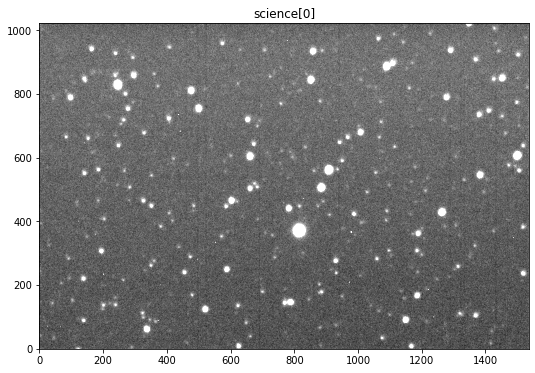

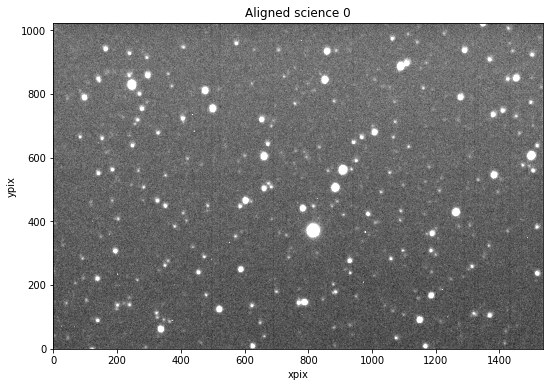

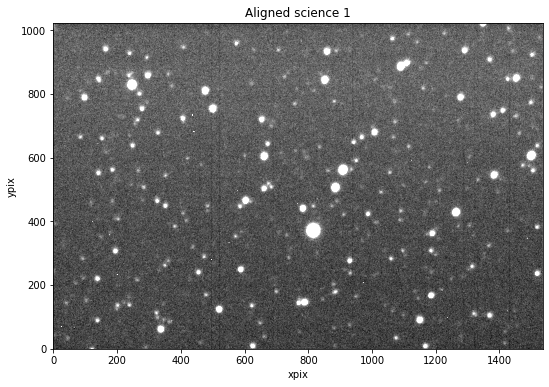

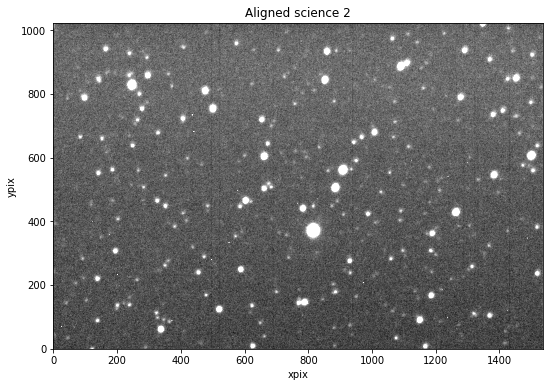

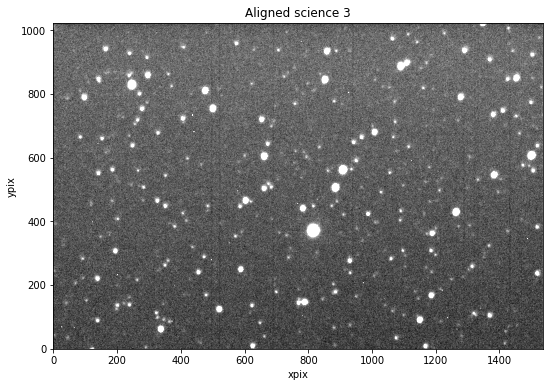

...

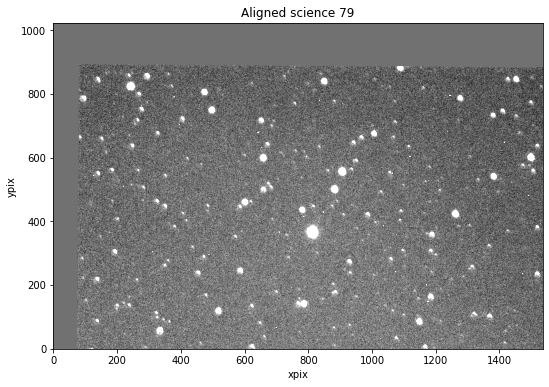

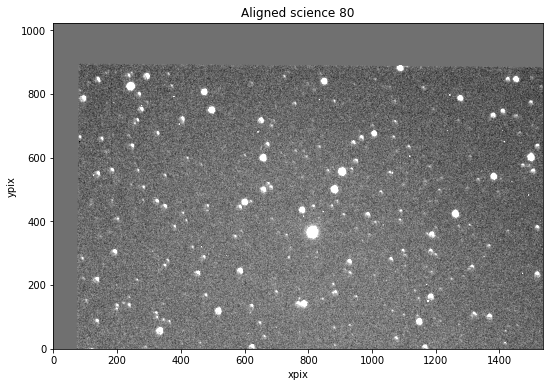

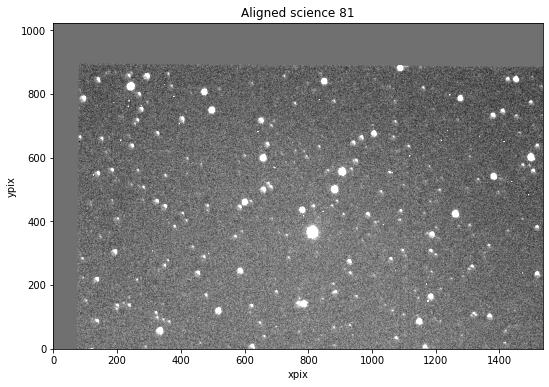

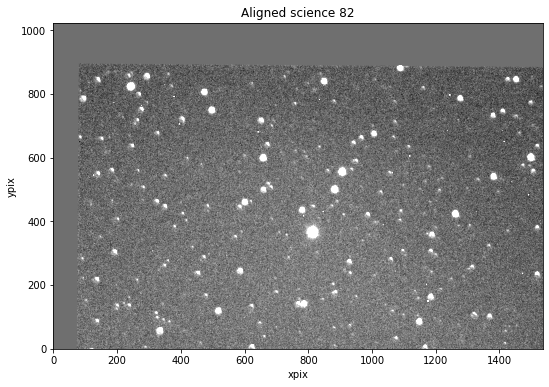

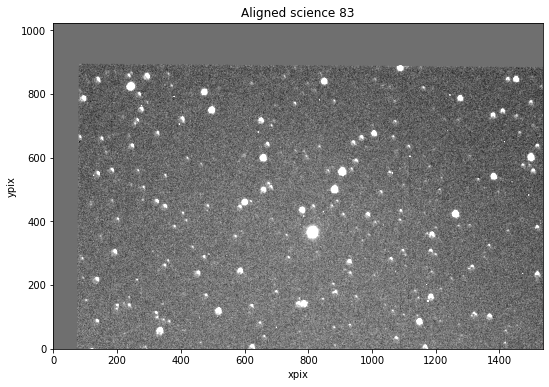

In [41]:
def align(science, filter):
  aligned_science = []
  print('Aligning all images with the following image:')
  fig,ax = plt.subplots(1,1,figsize=(12,6))

  lo,up = np.percentile(science[0],1),np.percentile(science[0],99)
  ax.imshow(science[0],cmap='gray',origin='lower',clim=(lo,up))
  ax.set_title('science[0]')
  k = 0
  for i in science:
    if (filter=='black' and (k==5 or k==6 or k==7 or k==8 or k==9 or k==30 or k==38 or k==43 or k==44)):
      k=k+1
      continue

    aligned_image, footprint = aa.register(i, science[0]) #alinha a 1a para ficar na posicao da 2a
    fig,ax = plt.subplots(1,1,figsize=(12,6))

    lo,up = np.percentile(aligned_image,1),np.percentile(aligned_image,99)
    ax.imshow(aligned_image,cmap='gray',origin='lower',clim=(lo,up))

    ax.set_title('Aligned science %i' %k)
    k=k+1
    ax.set(xlabel='xpix', ylabel='ypix')
    aligned_science.append(aligned_image)

  return aligned_science

aligned_reduced_science_black = align(reduced_science_black, 'black')

In [ ]:
#aligned_reduced_science_blue = align(reduced_science_blue, 'blue')
#aligned_reduced_science_red = align(reduced_science_red, 'red')
#aligned_reduced_science_green = align(reduced_science_green, 'green')

Estimating centroid of aligned reduced images with no filter (black)

In [43]:
!pip install photutils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 826 kB 5.2 MB/s 


In [44]:
## Rough position obtained with the mouse
pos = [820,370]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: `photutils.centroid_com` is a deprecated alias for `photutils.centroids.centroid_com`. Instead, please use `from photutils.centroids import centroid_com` to silence this warning.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: `photutils.centroid_2dg` is a deprecated alias for `photutils.centroids.centroid_2dg`. Instead, please use `from photutils.centroids import centroid_2dg` to silence this warning.
  


(array([814.62460612, 369.1218506 ]), array([814.62460612, 369.1218506 ]))
(array([815.69572135, 369.88615089]), array([815.69572135, 369.88615089]))


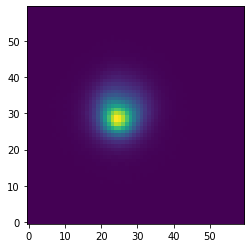

In [45]:
## Get centroid
from photutils import centroid_com, centroid_2dg  #load centroid libraries
subdata = aligned_reduced_science_black[0][pos[1]-30:pos[1]+30,pos[0]-30:pos[0]+30] #select subportion of image aligned_reduced_science_black[0]

plt.imshow(subdata,origin='lower')

center = centroid_2dg(subdata)+pos-[30,30],centroid_2dg(subdata)+pos-[30,30]
ccenter = centroid_com(subdata)+pos-[30,30],centroid_com(subdata)+pos-[30,30]
print(center)
print(ccenter)

Estimating the background

In [80]:
from astropy.stats import sigma_clipped_stats,gaussian_sigma_to_fwhm

mean, median, std = sigma_clipped_stats(aligned_reduced_science_black[0], sigma=3.0,maxiters=5) 
print((mean, median, std))


(115.04097529327085, 114.91511711768459, 9.870331746549766)


Find Stars

In [81]:
from photutils import DAOStarFinder

daofind = DAOStarFinder(fwhm=15, threshold=5.*std) #CHANGED FROM 5*STD TO 4*STD

sources = daofind(aligned_reduced_science_black[0]) #REMOVED THE '- MEDIAN'

print("     Found %i stars in image " %len(sources))
print(sources)

     Found 192 stars in image 
 id     xcentroid      ...        flux                mag         
--- ------------------ ... ------------------ --------------------
  1 122.30538963599264 ...  2.361861035217722  -0.9331358536281793
  2 290.15355945024027 ... 1.5210377711969523 -0.45534999703048334
  3  625.3047124617219 ... 11.911163965062768   -2.689885507591085
  4 1166.5983841505588 ...  9.481350161076605   -2.442175465115572
  5  882.8094306658639 ...  1.239709791399427 -0.23330007833943345
  6 1415.7886204198182 ... 1.7244350959312813   -0.591617132726414
  7 1075.2944405896728 ...  4.033359072689226   -1.514167217767525
  8  661.8022566435859 ... 2.2214524888020843  -0.8665925730647378
  9  5.735369182848478 ... 1.2121122404837614 -0.20885709240937994
 10  337.7903375566468 ...  31.87439994924308  -3.7586050442963606
...                ... ...                ...                  ...
182  706.6615807391455 ...   2.16715783429226  -0.8397263554407506
183  164.5989065928835 ... 10.0

Copy from here! New changes...

     Found 236 stars in image 


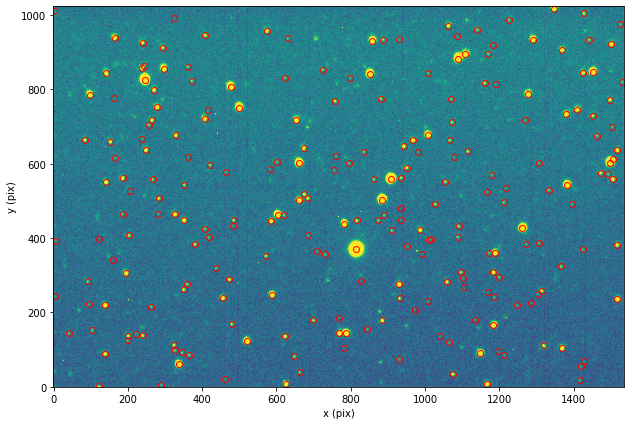

In [92]:
## Plot stars found
fig = plt.figure(figsize=(12,7))
l1 = np.percentile(aligned_reduced_science_black[0][np.isfinite(aligned_reduced_science_black[0])].flatten(), 1)
l2 = np.percentile(aligned_reduced_science_black[0][np.isfinite(aligned_reduced_science_black[0])].flatten(), 99)
plt.imshow(aligned_reduced_science_black[0],clim=(l1,l2),origin='lower')
plt.plot(sources["xcentroid"],sources["ycentroid"],'or',mfc='none')
plt.xlabel("x (pix)")
plt.ylabel("y (pix)")

print("     Found %i stars in image " %len(sources))

 id     xcentroid      ...        flux                mag        
--- ------------------ ... ------------------ -------------------
 83  814.5405338210397 ...  1210.400282724303  -7.707322541143226
126  907.5416939858835 ... 132.54917980560498  -5.305942611821179
183 246.98224942636378 ... 128.21549000535776  -5.269851241144781
114  883.8888116925766 ...  82.99343686071418  -4.797609374076468
138 1497.0700749804228 ...  66.08658029659736 -4.5502831988339585
 95 1261.2320978305333 ...  52.59116786772881  -4.302282037742838
137   660.897894929903 ...  43.87550700328277   -4.10555536997848
168 500.08271872845313 ... 37.451002138843414  -3.933658608329484
196 1088.6981847832674 ...  37.41966342862499 -3.9327496922934424
184  851.2740784525242 ... 35.152571675394704  -3.864892756076566
Magnitudes of the 10th brightest stars:
-7.707322541143226
-5.305942611821179
-5.269851241144781
-4.797609374076468
-4.5502831988339585
-4.302282037742838
-4.10555536997848
-3.933658608329484
-3.9327496922934

Text(0, 0.5, 'y (pix)')

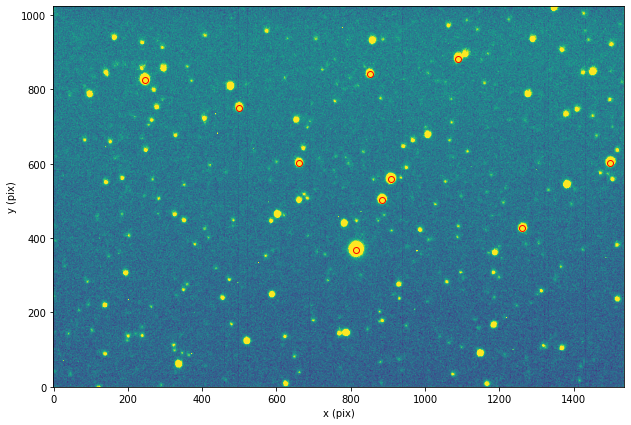

In [68]:
## Take nbright brightest stars and print list
nbright = 10
brightest = np.argsort(sources['flux'])[::-1][0:nbright]
brsources = sources[brightest]
print(brsources)

print('Magnitudes of the 10th brightest stars:')
for i,src in enumerate(brsources):
  print(float(src['mag']))

## Plot nbrightest stars found
fig = plt.figure(figsize=(12,7))
l1 = np.percentile(aligned_reduced_science_black[0][np.isfinite(aligned_reduced_science_black[0])].flatten(), 1)
l2 = np.percentile(aligned_reduced_science_black[0][np.isfinite(aligned_reduced_science_black[0])].flatten(), 99)
plt.imshow(aligned_reduced_science_black[0],clim=(l1,l2),origin='lower')
plt.plot(brsources["xcentroid"],brsources["ycentroid"],'or',mfc='none')
plt.xlabel("x (pix)")
plt.ylabel("y (pix)")





Gaussian fit

In [54]:
## Fit the Gaussian PSF to brightest stars
rmax = 25
(ny,nx) = np.shape(aligned_reduced_science_black[0])
from astropy.modeling import models,fitting
fit_g = fitting.LevMarLSQFitter()
allxfwhm, allyfwhm = np.zeros(len(brsources)),np.zeros(len(brsources))
allfwhm,alltheta = np.zeros(len(brsources)),np.zeros(len(brsources))
for i,src in enumerate(brsources):
  if int(src['ycentroid']) > rmax and int(src['ycentroid']) < ny-rmax and \
     int(src['xcentroid']) > rmax and int(src['xcentroid']) < nx-rmax:
    img = aligned_reduced_science_black[0][int(src['ycentroid'])-rmax:int(src['ycentroid'])+rmax,
                int(src['xcentroid'])-rmax:int(src['xcentroid'])+rmax]
    subx,suby = np.indices(img.shape) # instead of meshgrid
    p_init = models.Gaussian2D(amplitude=np.max(img),x_mean=rmax,y_mean=rmax,x_stddev=1.0,y_stddev=1.0)
    fitgauss = fit_g(p_init, subx, suby, img - np.min(img))
    allxfwhm[i] = np.abs(fitgauss.x_stddev.value)
    allyfwhm[i] = np.abs(fitgauss.y_stddev.value)
    allfwhm[i] = 0.5*(allxfwhm[i]+allyfwhm[i])
    alltheta[i] = fitgauss.theta.value
xfwhm,yfwhm = np.median(allxfwhm)*gaussian_sigma_to_fwhm,np.median(allyfwhm)*gaussian_sigma_to_fwhm
fwhm = np.median(allfwhm)*gaussian_sigma_to_fwhm
sigfwhm, sigxfwhm, sigyfwhm = np.std(allfwhm), np.std(allxfwhm), np.std(allyfwhm)
medtheta = np.median(alltheta)
print("     x-FWHM %f +/- %f (pix) for this image " %(xfwhm,sigxfwhm))
print("     y-FWHM %f +/- %f (pix) for this image " %(yfwhm,sigyfwhm))
print("     FWHM %f +/- %f (pix) for this image " %(fwhm,sigfwhm))

     x-FWHM 9.764635 +/- 0.500866 (pix) for this image 
     y-FWHM 9.774170 +/- 0.323468 (pix) for this image 
     FWHM 9.654399 +/- 0.402635 (pix) for this image 


In [82]:
daofind = DAOStarFinder(fwhm=9.654399, threshold=4.*std) #CHANGED FROM 5*STD TO 4*STD

sources = daofind(aligned_reduced_science_black[0]) #REMOVED THE '- MEDIAN'

print("     Found %i stars in image " %len(sources))
print(sources)

     Found 217 stars in image 
 id     xcentroid      ...        flux                 mag         
--- ------------------ ... ------------------ ---------------------
  1 290.24352111779046 ... 1.2743590785645533  -0.26322954304878937
  2  625.2243330519726 ...  9.997843536086235    -2.499765839656633
  3 1166.4335615299822 ...  7.937532977061052    -2.249213856529889
  4  882.7299814147444 ... 1.0081173006699664 -0.008777669732612483
  5 464.44178007204954 ... 1.1178279227790109  -0.12093738468250109
  6 1415.9270595479484 ...  1.682241622804612   -0.5647209357212741
  7 1074.6652039284475 ...  3.381282287683071   -1.3227035738128532
  8   46.3127057105986 ... 1.0149939083442445  -0.01615858941515033
  9  662.0472290899214 ...  2.197117113354978   -0.8546330170489486
 10  5.240997263391798 ... 1.2599929006979704  -0.25092024534076685
...                ... ...                ...                   ...
207 164.60830116057033 ...  8.524716077874354   -2.3266998084968713
208   574.3497494

Plotting magnitude of the brightest star over time

In [96]:
k = 0

nbright=10

magnitudes = []
for i in aligned_reduced_science_black:
  mean, median, std = sigma_clipped_stats(i, sigma=3.0,maxiters=5) 
  sources = daofind(i) #REMOVED THE '- MEDIAN'
  brightest = np.argsort(sources['flux'])[::-1][0:nbright] #taking the nbright brightests star
  brsources = sources[brightest]
  k = k+1
  aux = []
  for j,src in enumerate(brsources):
    aux.append(float(src['mag']))
    #print('iteration = ', k, ', magnitude = ', float(src['mag']))
  magnitudes.append(aux)
print(magnitudes)

  

[[-7.707322541143226, -5.3059426118211785, -5.269851241144781, -4.797609374076467, -4.5502831988339585, -4.302282037742837, -4.105555369978481, -3.9336586083294844, -3.932749692293443, -3.864892756076566], [-7.372963238333855, -4.908824694388454, -4.889349612672621, -4.354217218655963, -4.150212366298918, -3.9238339719821598, -3.6855488630977105, -3.558165253284114, -3.542669539267067, -3.471648000251725], [-7.563488757981044, -5.155368317107247, -5.087545316732428, -4.611609212161528, -4.4738881212249275, -4.203100144780728, -3.9734733372952435, -3.800948256418267, -3.757360907553391, -3.7084729983853535], [-7.948891597086836, -5.523335707813014, -5.515789463932795, -4.980867401633639, -4.835598200878629, -4.557737141659001, -4.319390931827693, -4.214987015575968, -4.185255638354221, -4.164578338551053], [-7.836756707351304, -5.406394479828906, -5.401074216332863, -4.886115653763773, -4.727135993247868, -4.484569223328013, -4.207354965787082, -4.0988759920066, -4.069573865011766, -4.0

In [98]:
print(len(magnitudes))
print(magnitudes[0])


75
[-7.707322541143226, -5.3059426118211785, -5.269851241144781, -4.797609374076467, -4.5502831988339585, -4.302282037742837, -4.105555369978481, -3.9336586083294844, -3.932749692293443, -3.864892756076566]


Plotting magnitudes over time (one curve per each of the brightest stars)

In [105]:
"""10 stars
75 epochs"""


x = np.linspace(0, len(magnitudes) + 1, num=len(magnitudes))

print(x)
print(len(x))
print(len(magnitudes[0]))
"""
i = 0
for i in range(len(magnitudes)):
  plt.scatter(x, magnitudes[i])
  i = i+1
plt.show()"""

[ 0.          1.02702703  2.05405405  3.08108108  4.10810811  5.13513514
  6.16216216  7.18918919  8.21621622  9.24324324 10.27027027 11.2972973
 12.32432432 13.35135135 14.37837838 15.40540541 16.43243243 17.45945946
 18.48648649 19.51351351 20.54054054 21.56756757 22.59459459 23.62162162
 24.64864865 25.67567568 26.7027027  27.72972973 28.75675676 29.78378378
 30.81081081 31.83783784 32.86486486 33.89189189 34.91891892 35.94594595
 36.97297297 38.         39.02702703 40.05405405 41.08108108 42.10810811
 43.13513514 44.16216216 45.18918919 46.21621622 47.24324324 48.27027027
 49.2972973  50.32432432 51.35135135 52.37837838 53.40540541 54.43243243
 55.45945946 56.48648649 57.51351351 58.54054054 59.56756757 60.59459459
 61.62162162 62.64864865 63.67567568 64.7027027  65.72972973 66.75675676
 67.78378378 68.81081081 69.83783784 70.86486486 71.89189189 72.91891892
 73.94594595 74.97297297 76.        ]
75
10


'\ni = 0\nfor i in range(len(magnitudes)):\n  plt.scatter(x, magnitudes[i])\n  i = i+1\nplt.show()'

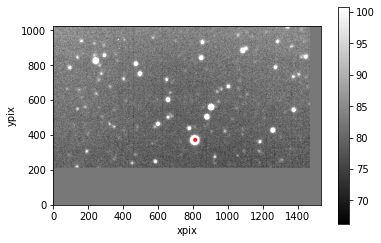

In [ ]:

import numpy as np

import matplotlib.pyplot as plt

from astropy.visualization import SqrtStretch

from astropy.visualization.mpl_normalize import ImageNormalize

from photutils.aperture import CircularAperture

positions = np.transpose((sources['xcentroid'], sources['ycentroid']))

plot_image(aligned_image, 'gray')

apertures = CircularAperture(positions, r=6.)

apertures.plot(color='red', lw=1.5, alpha=0.5)

=> plot 10 brightest stars


=> compare with nearby stars (around 10 is good) in different epochs. To identify variable stars we should compare them with eachother (groups of 3 for ex)

=>prof will tell us how to calculate de fwhm but use 10 by now